# Zadania

Celem zadań jest napisanie (fragmentów) programów, które wyodrębnią obiekty znajdujące się na podanych obrazach. Rozumie się przez to doprowadzenie obrazów do postaci binarnej z wyraźną separacją między obiektami a tłem oraz poszczególnymi obiektami.

Samo osiągnięcie "jakiegoś" wyniku ([`cv2.threshold`](https://docs.opencv.org/3.4/d7/d1b/group__imgproc__misc.html#gae8a4a146d1ca78c626a53577199e9c57) odpalone, próg wybrany "z palca", _coś tam_ widać, wynik wyświetlony) to co najwyżej połowa sukcesu (i oceny). Ważne jest pokazanie w drodze eksperymentu odpowiedzi na pytania - czy te podane w treści zadania, czy takie, które się Tobie nasunęły.

In [10]:
import cv2
import numpy as np
from PIL import Image

# Zad. 1: Monety szare

Dane są dwa czarno-białe obrazy monet, `monety_szare` oraz `monety_szare_szum`, z których drugi zawiera pewien poziom zakłóceń. Dokonaj binaryzacji tych obrazów za pomocą progowania.  
W jaki sposób ustalisz wartość progu? Jak wartość progu wpływa na wyniki?  
Jaki wpływ mają zakłócenia w drugim obrazie? Jak się ich pozbędziesz?

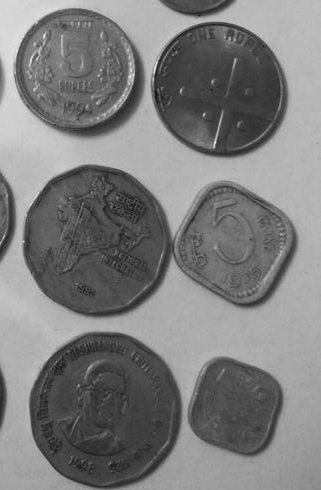

In [11]:
# 1A
monety_szare = cv2.imread('Monety_szare.bmp')
Image.fromarray(cv2.cvtColor(monety_szare, cv2.COLOR_BGR2RGB))

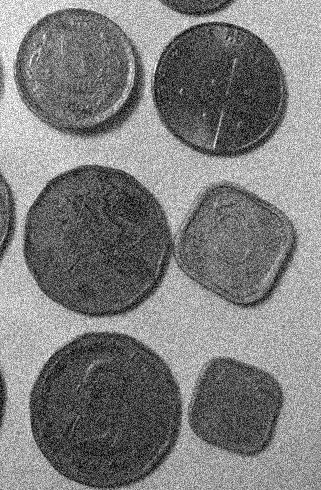

In [12]:
# 1B
monety_szare_szum = cv2.imread('Monety_szare_szum.bmp')
Image.fromarray(cv2.cvtColor(monety_szare_szum, cv2.COLOR_BGR2RGB))

## Rozwiązanie części 1A:

In [13]:
type(monety_szare)
monety_szare.shape

(490, 321, 3)

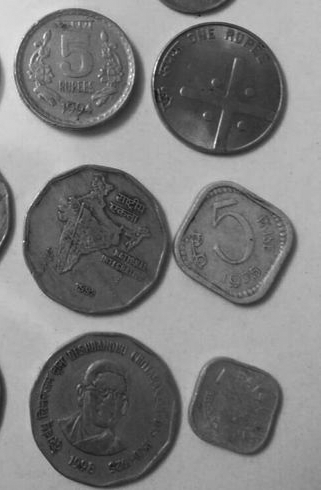

In [14]:
monety_szare_gray = cv2.cvtColor(monety_szare, cv2.COLOR_BGR2GRAY)
Image.fromarray(monety_szare_gray)

In [15]:
import matplotlib.pyplot as plt

In [16]:
def show_histogram(image, title = 'Histogram'):
    plt.hist(image[..., 0].flatten(), bins=255, range=[0, 255])
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.title(title)
    plt.show()

In [17]:
def apply_threshold(image, threshold, max_value):
    (T, img_thresh) = cv2.threshold(image, threshold, max_value, cv2.THRESH_BINARY_INV)

    print("Próg: ", T)
    return img_thresh

In [18]:
def show_image_with_title(image, title, size=(10, 10)):
    plt.figure(figsize=size)
    plt.imshow(image, cmap='gray')
    plt.title(title)
    plt.show()


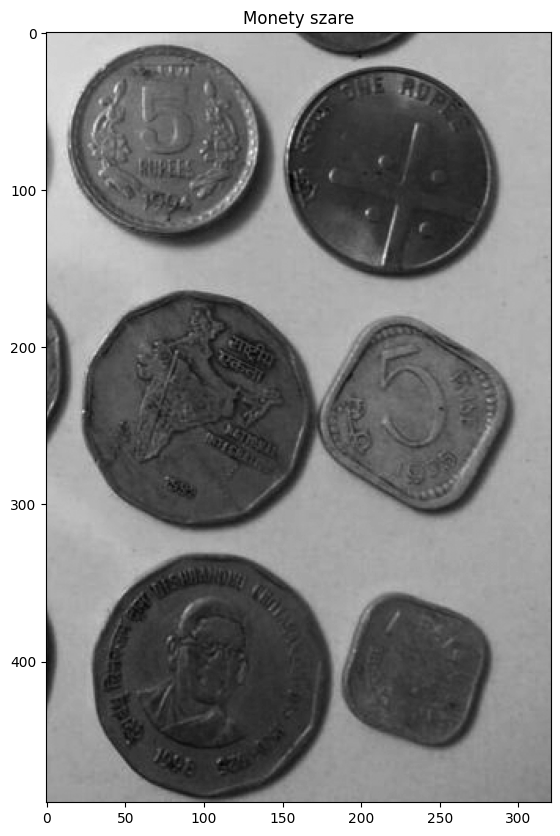

In [19]:
show_image_with_title(monety_szare_gray, 'Monety szare')

### Histogramy 

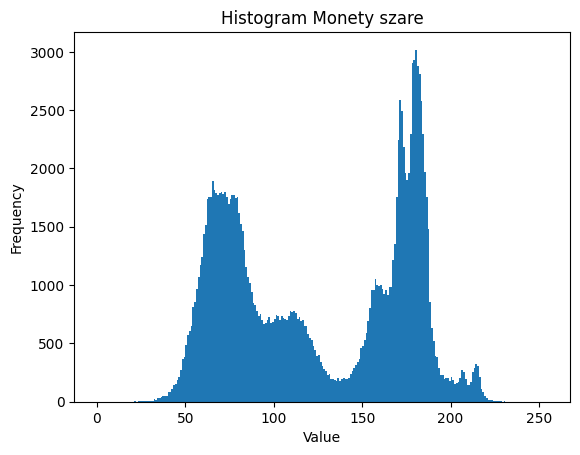

In [20]:
show_histogram(monety_szare, "Histogram Monety szare")

### Progowanie z palca

No najlepszym było znalezienie progu analizując histogram. Mamy wiele wartości szarych, oraz jaśniejszych. Na histogramie widać lukę występujących pikseli.

Można spróbować z 'palca' i 'oka' znaleźć wartość progu, która oddzieli tło od monet.

Próg:  140.0


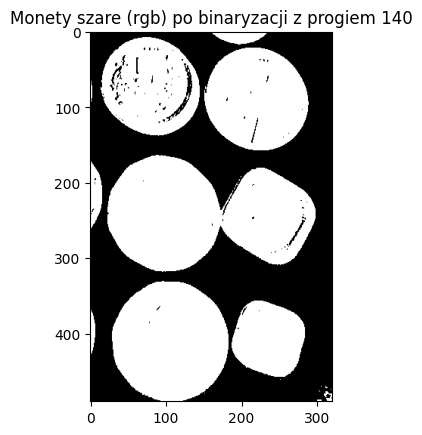

In [15]:
theshold = 140
img_thres = apply_threshold(monety_szare, theshold, 255)
show_image_with_title(img_thres, f"Monety szare (bgr) po binaryzacji z progiem {theshold}")

Próg:  140.0


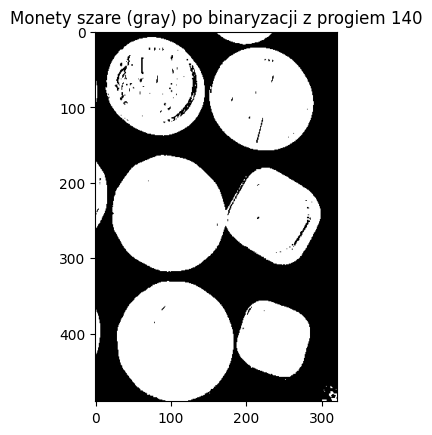

In [14]:
img_thres_gray = apply_threshold(monety_szare_gray, theshold, 255)
show_image_with_title(img_thres_gray, f"Monety szare (gray) po binaryzacji z progiem {theshold}")

No i niby ok, natomiast widać, że monety posiadają taką teksturę, że niektóre piksele należące do monet nie należą do tła.

Użycie metody Otsu, która znajduje wartość progu, która minimalizuje wariancję międzyklasową. W tym przypadku, wartość progu jest znacznie wyższa niż wartość progu znaleziona 'z palca'.

https://docs.opencv.org/4.x/d7/d4d/tutorial_py_thresholding.html

In [17]:
T, otsu_thresh_img = cv2.threshold(
    monety_szare, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)

Image.fromarray(otsu_thresh_img)

error: OpenCV(4.10.0) /Users/xperience/GHA-Actions-OpenCV/_work/opencv-python/opencv-python/opencv/modules/imgproc/src/thresh.cpp:1559: error: (-2:Unspecified error) in function 'double cv::threshold(cv::InputArray, cv::OutputArray, double, double, int)'
> THRESH_OTSU mode:
>     'src_type == CV_8UC1 || src_type == CV_16UC1'
> where
>     'src_type' is 16 (CV_8UC3)


Wniosek: Otsu nie działa przy RGB?

In [18]:
monety_szare_rgb = cv2.cvtColor(monety_szare, cv2.COLOR_BGR2RGB)
T, otsu_thresh_img_rgb = cv2.threshold(
    monety_szare_rgb, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)


error: OpenCV(4.10.0) /Users/xperience/GHA-Actions-OpenCV/_work/opencv-python/opencv-python/opencv/modules/imgproc/src/thresh.cpp:1559: error: (-2:Unspecified error) in function 'double cv::threshold(cv::InputArray, cv::OutputArray, double, double, int)'
> THRESH_OTSU mode:
>     'src_type == CV_8UC1 || src_type == CV_16UC1'
> where
>     'src_type' is 16 (CV_8UC3)


### Użycie metody Otsu

Próg wyliczony algorytmem Otsu:  127.0


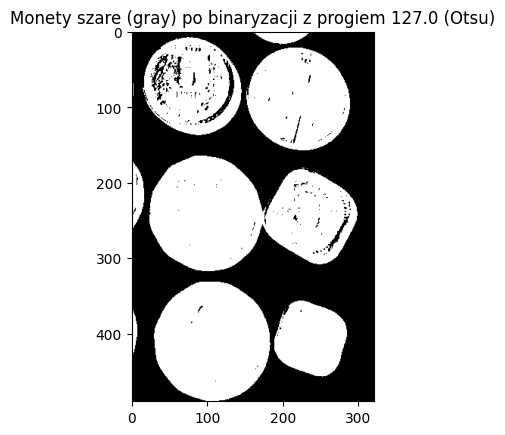

In [16]:
T, otsu_thresh_img = cv2.threshold(
    monety_szare_gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)
show_image_with_title(otsu_thresh_img, f"Monety szare (gray) po binaryzacji z progiem {T} (Otsu)")

## Rozwiązanie części 1B:


### Histogramy

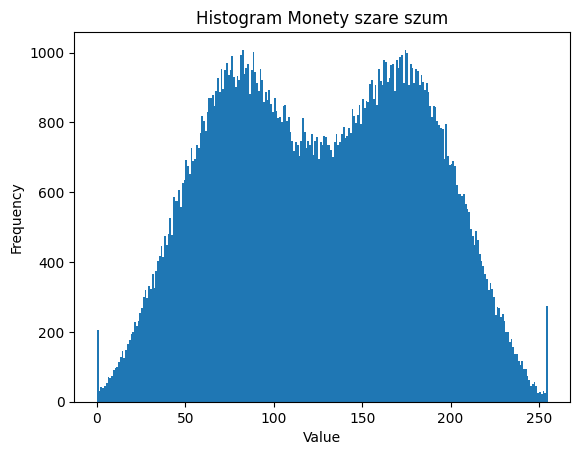

In [25]:
show_histogram(monety_szare_szum, "Histogram Monety szare szum")

Wniosek: szum bardzo wpływa na histogram

### Nieskuteczny thresholding

Próg:  120.0


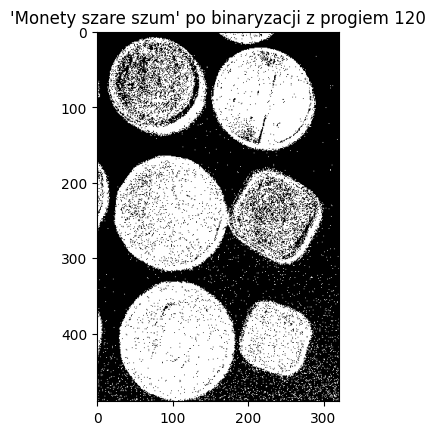

In [28]:
theshold_2 = 120
monety_szare_szum_thresh = apply_threshold(monety_szare_szum, theshold_2, 255)
show_image_with_title(monety_szare_szum_thresh, f"'Monety szare szum' po binaryzacji z progiem {theshold_2}")

Ostu ze szumem:

Próg wyliczony algorytmem Otsu:  125.0


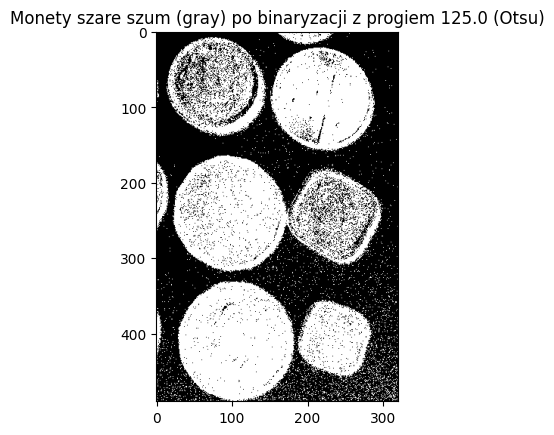

In [29]:
T, monety_szare_szum_otsu_thresh_img = cv2.threshold(
    monety_szare_szum_gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)

show_image_with_title(monety_szare_szum_otsu_thresh_img, f"Monety szare szum (gray) po binaryzacji z progiem {T} (Otsu)")

### Porównanie różnego rodziaju filtrów na działanie metody Otsu

Uśredniający

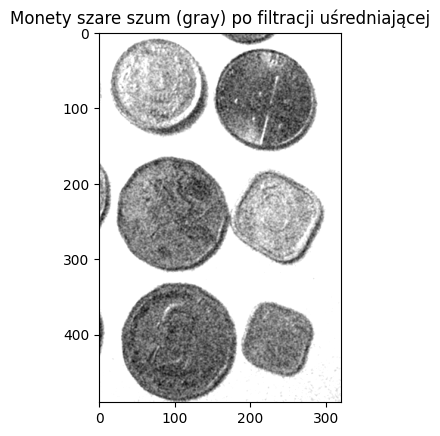

In [31]:
kernel_blur_matrix = (
    np.array([[1, 2, 1], 
              [2, 4, 2], 
              [1, 2, 1]]) / 9
)

monety_szare_szum_blur = cv2.filter2D(src=monety_szare_szum_gray, ddepth=-1, kernel=kernel_blur_matrix)

show_image_with_title(monety_szare_szum_blur, "Monety szare szum (gray) po filtracji uśredniającej")

Próg wyliczony algorytmem Otsu:  191.0


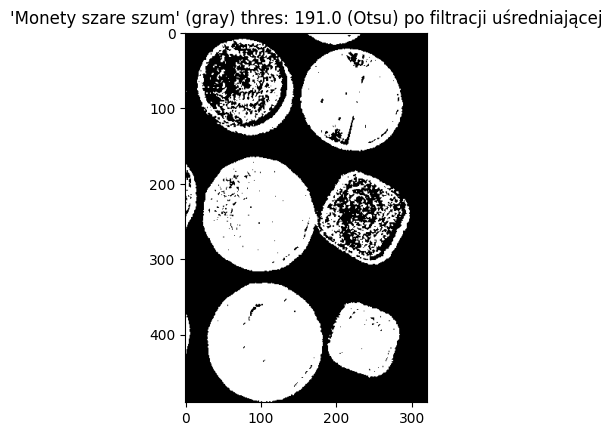

In [33]:
T, monety_szare_szum_blur_otsu_thresh_img = cv2.threshold(
    monety_szare_szum_blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)
show_image_with_title(monety_szare_szum_blur_otsu_thresh_img, f"'Monety szare szum' (gray) thres: {T} (Otsu) po filtracji uśredniającej")

Medianowy

Filtr mediany:
1. kształt maski: kwadratowa, rozmiar
1. posortowanie wartości pikseli w masce
1. wartość piksela w miejscu maski: mediana wartości pikseli w masce

ksize = rozmiar liniowy `przysłony`

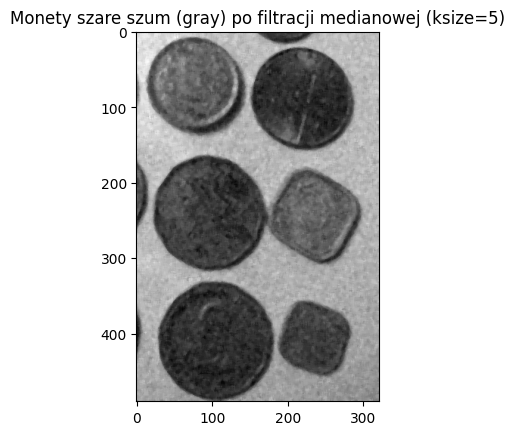

In [34]:
ksize = 5
monety_szare_szum_median_blur = cv2.medianBlur(monety_szare_szum_gray, ksize)
show_image_with_title(
    monety_szare_szum_median_blur, 
    f"Monety szare szum (gray) po filtracji medianowej (ksize={ksize})"
)

Rzekomo medianowy jest dobry do usuwania "pierzu i soli" ale nie jestem pewien czy to jest to jest ten sam

Próg wyliczony algorytmem Otsu po median blur:  128.0


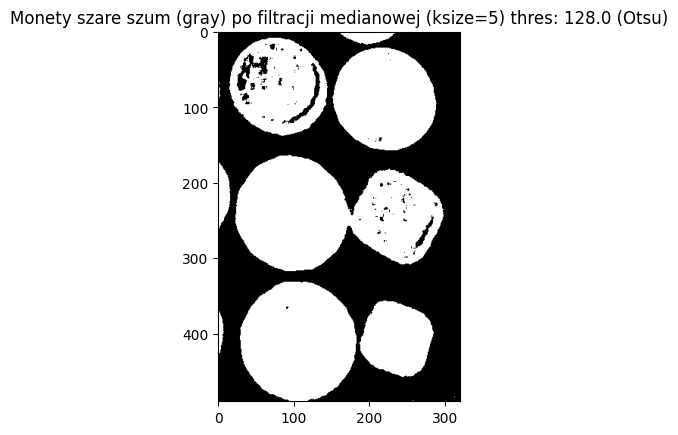

In [35]:
T, monety_szare_szum_median_blur_otsu_thresh_img = cv2.threshold(
    monety_szare_szum_median_blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu po median blur: ", T)

show_image_with_title(
    monety_szare_szum_median_blur_otsu_thresh_img, 
    f"Monety szare szum (gray) po filtracji medianowej (ksize={ksize}) thres: {T} (Otsu)"
)

Gausowski   


- src: The source image on which the blur will be applied.
 - ksize: The size of the Gaussian kernel. It should be a tuple of two integers representing the width and height of the kernel. Both values must be positive and odd.
 - sigmaX: The standard deviation in the X direction for the Gaussian kernel. If 0, it is calculated from the kernel size.
- sigmaY: The standard deviation in the Y direction for the Gaussian kernel. If 0, it is calculated from the kernel size. If not provided, it defaults to the same value as sigmaX.
 - borderType: (Optional) The pixel extrapolation method. It defaults to cv2.BORDER_DEFAULT.

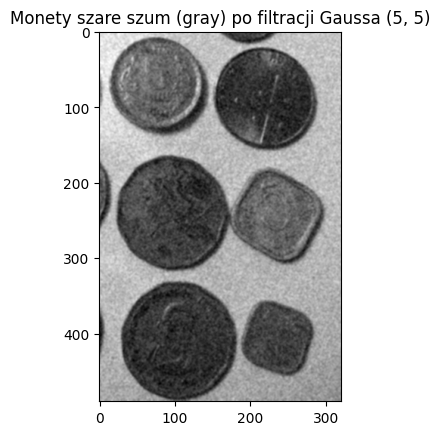

In [36]:
monety_szare_szum_gaussian_blur = cv2.GaussianBlur(monety_szare_szum_gray, (5, 5), 0)

show_image_with_title(
    monety_szare_szum_gaussian_blur, 
    "Monety szare szum (gray) po filtracji Gaussa (5, 5)"
)

Próg wyliczony algorytmem Otsu po Gaussian blur:  127.0


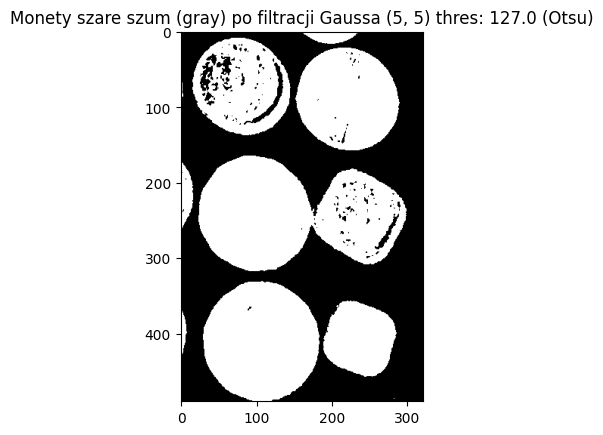

In [37]:

T, monety_szare_szum_gaussian_blur_otsu_thresh_img = cv2.threshold(
    monety_szare_szum_gaussian_blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu po Gaussian blur: ", T)

show_image_with_title(
    monety_szare_szum_gaussian_blur_otsu_thresh_img, 
    f"Monety szare szum (gray) po filtracji Gaussa (5, 5) thres: {T} (Otsu)"
)

# Zad. 2: Monety kolorowe

Na podobnej zasadzie dokonaj binaryzacji poniższych obrazów kolorowych. Skorzystaj z modelu barw HSV. Uzasadnij dobór progu w oparciu o histogram wybranej składowej.

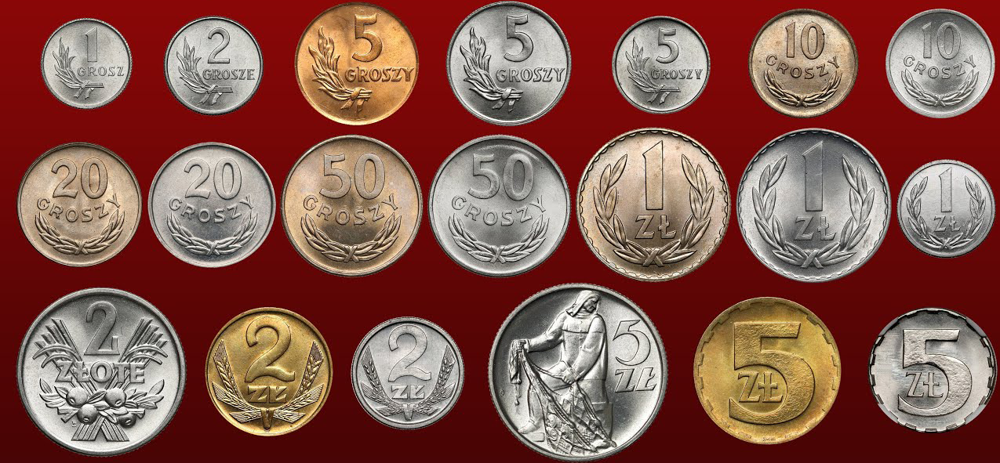

In [39]:
# 2A
monety_kolor = cv2.imread('Monety_kolor.bmp')
Image.fromarray(cv2.cvtColor(monety_kolor, cv2.COLOR_BGR2RGB))

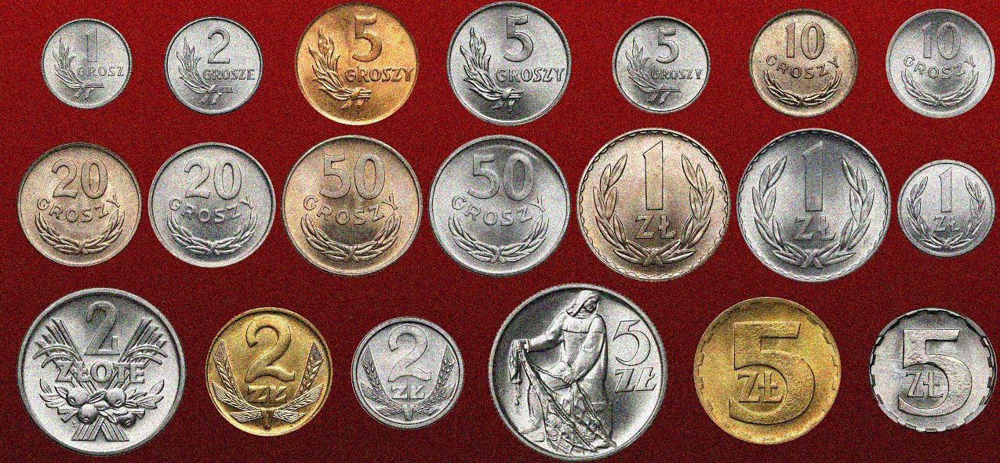

In [53]:
# 2B
monety_kolor_szum = cv2.imread('Monety_kolor_szum.bmp')
Image.fromarray(cv2.cvtColor(monety_kolor_szum, cv2.COLOR_BGR2RGB))

## Rozwiązanie części 2A:

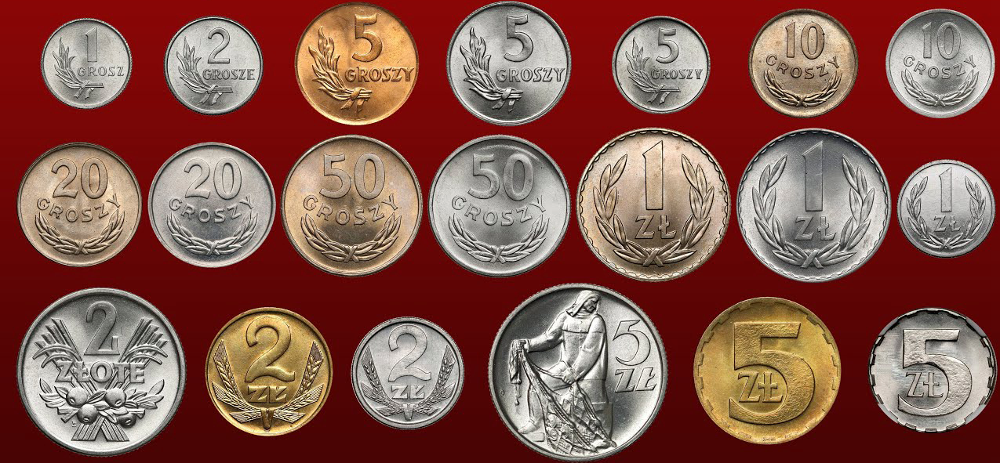

In [41]:
monety_kolor_hsv = cv2.cvtColor(monety_kolor, cv2.COLOR_BGR2HSV)
Image.fromarray(cv2.cvtColor(monety_kolor_hsv, cv2.COLOR_HSV2RGB))

### Histogramy HSV

In [1]:
def show_hsv_histogram(image, main_title='HSV Histogram'):
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv_image)

    plt.figure(figsize=(12, 6))
    plt.suptitle(main_title)

    plt.subplot(131)
    plt.hist(h.flatten(), bins=180, color='r')
    plt.xlabel('Hue degree')
    plt.ylabel("Frequency")

    plt.title('Hue Histogram')

    plt.subplot(132)
    plt.hist(s.flatten(), bins=256, color='g')
    plt.xlabel("Saturation value")
    plt.ylabel("Frequency")

    plt.title('Saturation Histogram')

    plt.subplot(133)
    plt.hist(v.flatten(), bins=256, color='b', range=[0, 256])
    plt.xlabel('Value')
    plt.title('Value Histogram')

    plt.tight_layout()
    plt.ylabel('Frequency')

    plt.show()

show_hsv_histogram(monety_kolor, 'HSV histogram: Monety kolor')

NameError: name 'monety_kolor' is not defined

Widać, że jest dużo koloru czerwonego = 0 i 180 stopni. widać, przerwę pomiędzy kolejnymi wartościami hue.

Również widać, analizując histogram saturation, że wartości są skupione w okolicach 0 i 240. Rozumiem, że kolor czerwony jest dość instensywny, więc wartość saturation jest wysoka. Monety szare, mniej intensywne

In [44]:
red_lower_1 = np.array([0, 170, 50])
red_upper_1 = np.array([10, 255, 255])
red_lower_2 = np.array([170, 170, 50])
red_upper_2 = np.array([180, 255, 255])


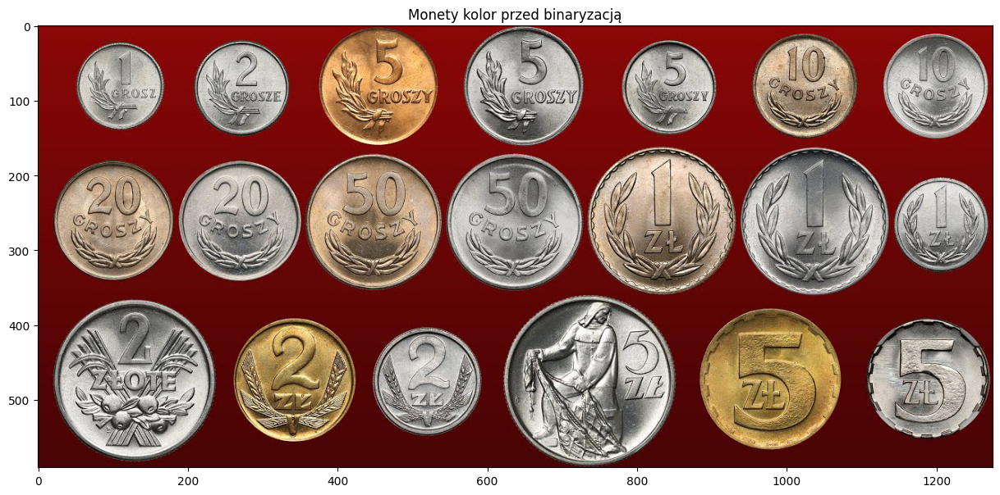

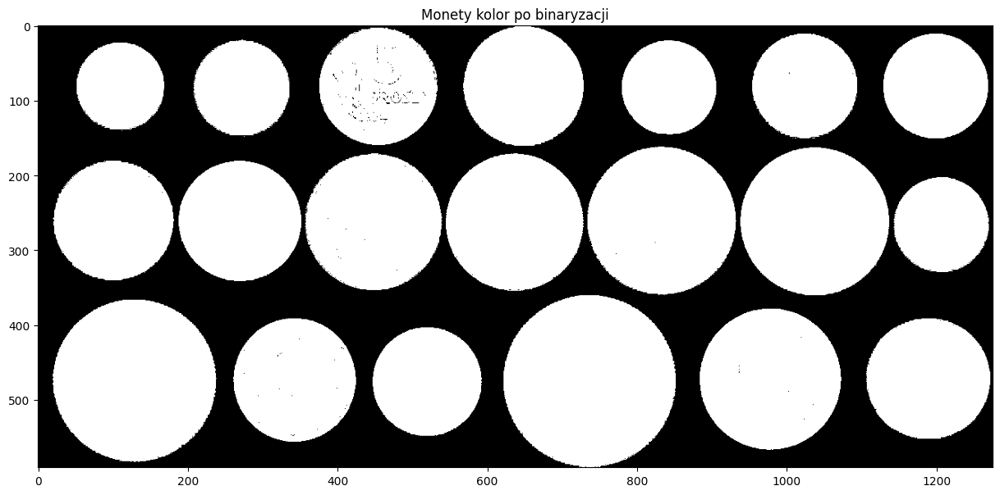

In [63]:
mask = cv2.inRange(monety_kolor_hsv, red_lower_1, red_upper_1) + cv2.inRange(monety_kolor_hsv, red_lower_2, red_upper_2)
mask = cv2.bitwise_not(mask)
show_image_with_title(
    cv2.cvtColor(monety_kolor, cv2.COLOR_BGR2RGB),
    "Monety kolor przed binaryzacją",
    size=(15, 15),
)
show_image_with_title(mask, "Monety kolor po binaryzacji", size=(15, 15))

## Rozwiązanie części 2B:


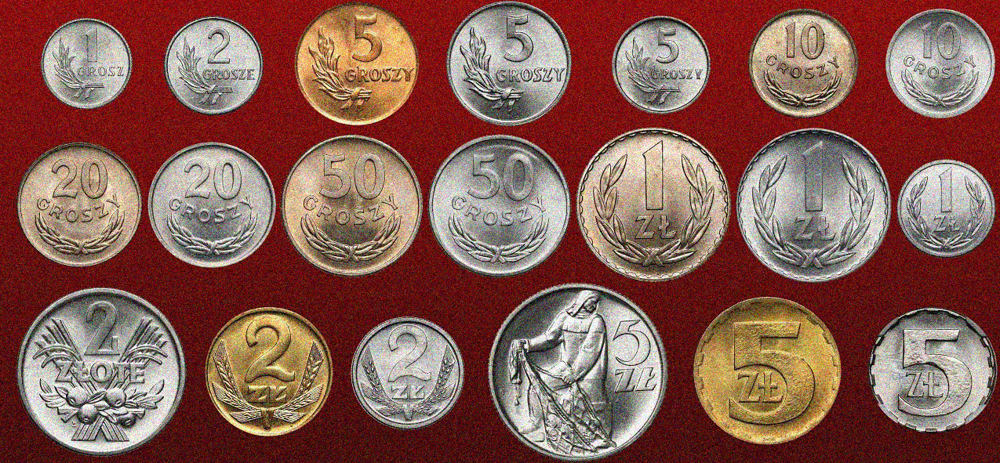

In [54]:
monety_kolor_szum_hsv = cv2.cvtColor(monety_kolor_szum, cv2.COLOR_BGR2HSV)
Image.fromarray(cv2.cvtColor(monety_kolor_szum_hsv, cv2.COLOR_HSV2RGB))

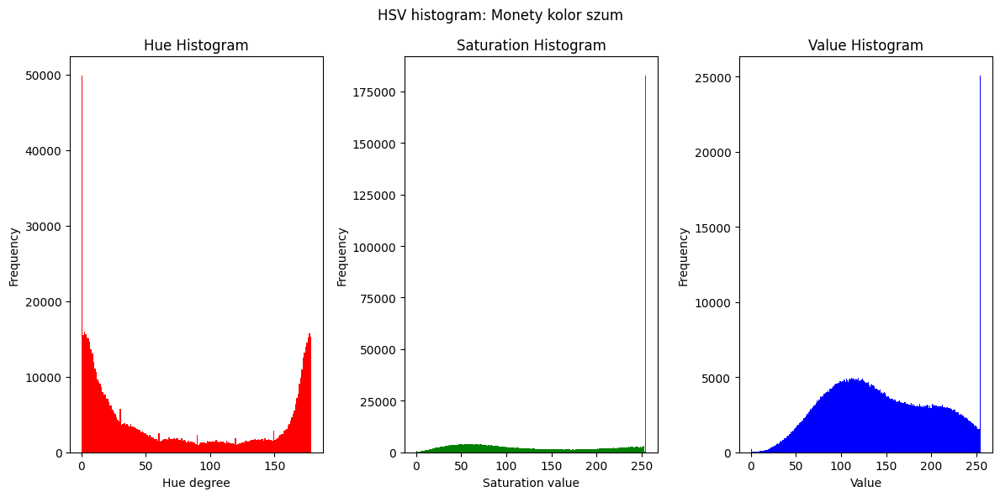

In [55]:
monety_kolor_szum_hsv = cv2.cvtColor(monety_kolor_szum, cv2.COLOR_BGR2HSV)

show_hsv_histogram(monety_kolor_szum, 'HSV histogram: Monety kolor szum')

### Mocna uwaga:
- nie należy wykonywać filtracji na hsv.

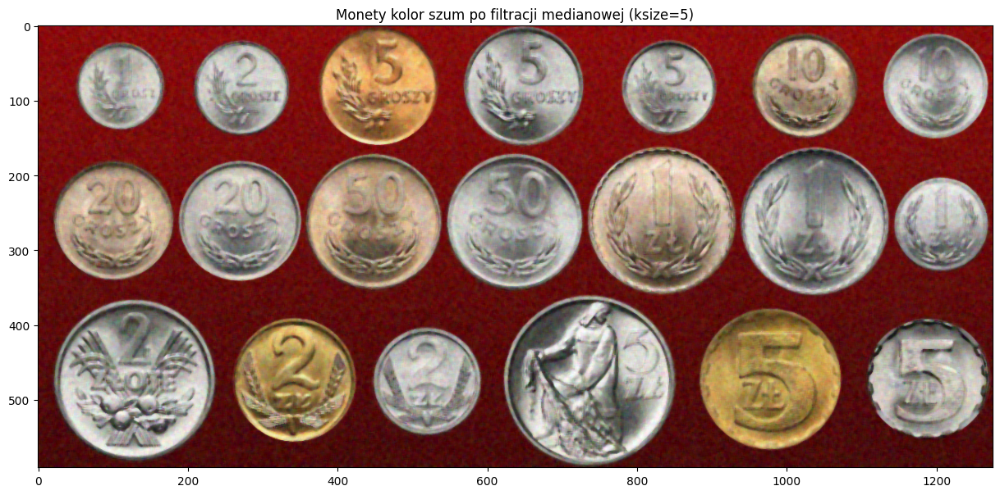

In [58]:
ksize_2 = 5
monety_kolor_szum_blur = cv2.medianBlur(monety_kolor_szum, ksize_2)
show_image_with_title(
    cv2.cvtColor(monety_kolor_szum_blur, cv2.COLOR_BGR2RGB),
    f"Monety kolor szum po filtracji medianowej (ksize={ksize_2})",
    size=(15, 15)
)

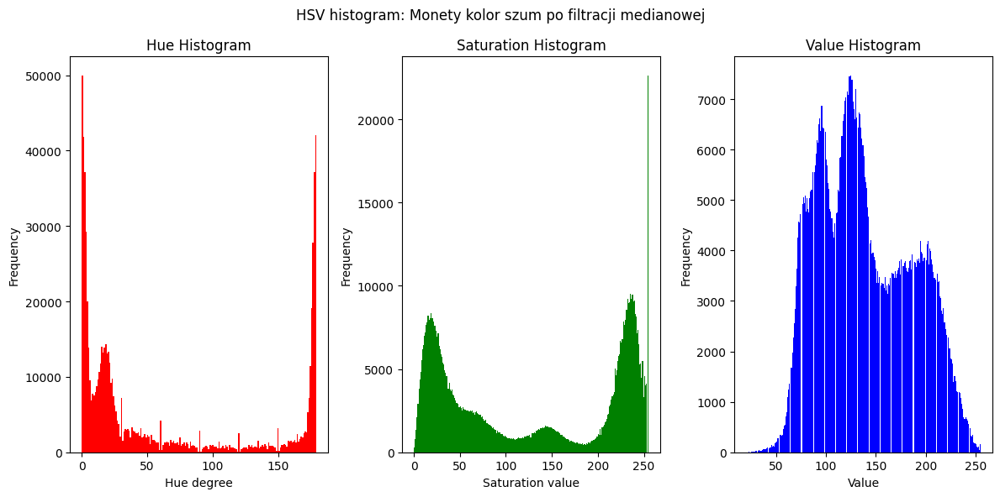

In [59]:
monety_kolor_szum_blur_hsv = cv2.cvtColor(monety_kolor_szum_blur, cv2.COLOR_BGR2HSV)
show_hsv_histogram(monety_kolor_szum_blur, 'HSV histogram: Monety kolor szum po filtracji medianowej')

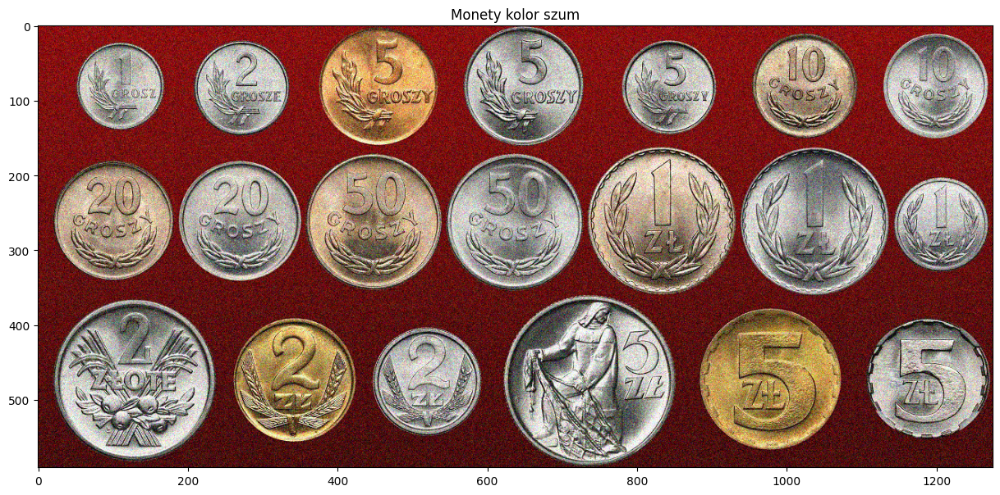

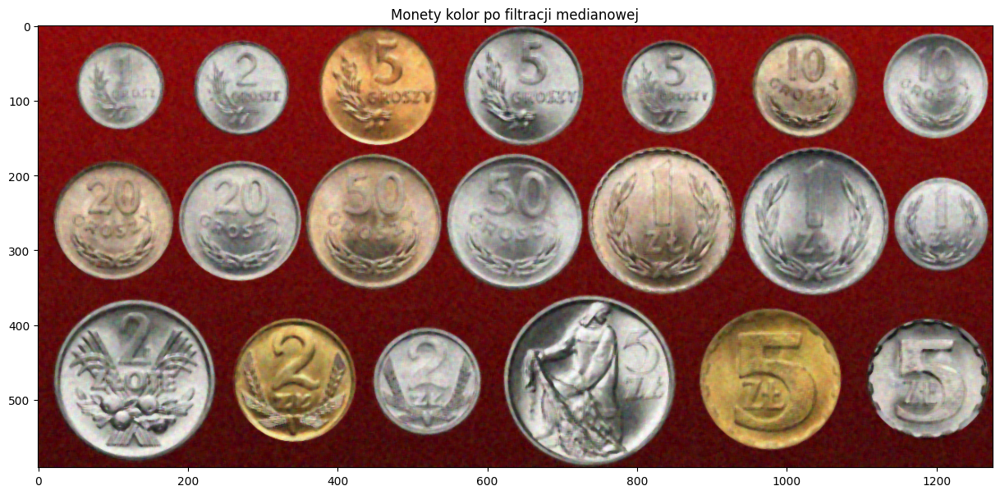

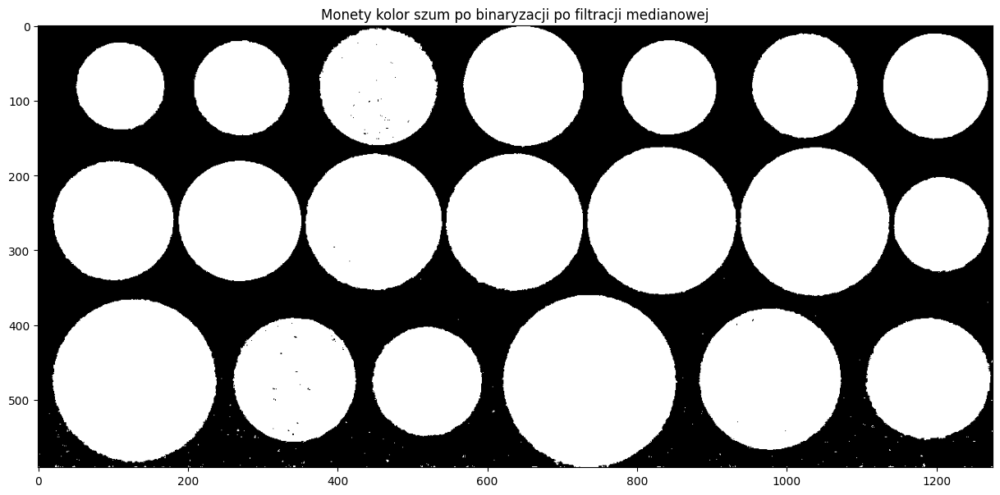

In [62]:
blur_red_lower_1 = np.array([0, 170, 50])
blur_red_upper_1 = np.array([10, 255, 255])
blur_red_lower_2 = np.array([170, 170, 50])
blur_red_upper_2 = np.array([180, 255, 255])

mask_blur = cv2.inRange(
    monety_kolor_szum_blur_hsv, blur_red_lower_1, blur_red_upper_1
) + cv2.inRange(monety_kolor_szum_blur_hsv, blur_red_lower_2, blur_red_upper_2)
mask_blur = cv2.bitwise_not(mask_blur)

show_image_with_title(
    cv2.cvtColor(monety_kolor_szum, cv2.COLOR_BGR2RGB),
    "Monety kolor szum",
    size=(15, 15),
)
show_image_with_title(
    cv2.cvtColor(monety_kolor_szum_blur, cv2.COLOR_BGR2RGB),
    "Monety kolor po filtracji medianowej",
    size=(15, 15),
)
show_image_with_title(
    mask_blur, "Monety kolor szum po binaryzacji po filtracji medianowej", size=(15, 15)
)

# Zad. 3: Tekst

W tym przypadku należy wyodrębnić litery od bardzo nierównomiernie oświetlonego tła. Skorzystaj z binaryzacji metodą Otsu. Zastosuj binaryzację w sposób lokalny (oknem przesuwnym). Jaki wpływ ma rozmiar okna na jakość binaryzacji? Jak przesuwać okno?

_(Pełna punktacja za zadanie wymaga własnoręcznej implementacji okna przesuwnego i filtracji wewnątrz niego. Użycie zamiast tego_ `cv2.adaptiveThreshold` _liczone jako pół zadania, przy założeniu zrozumienia tej metody.)_

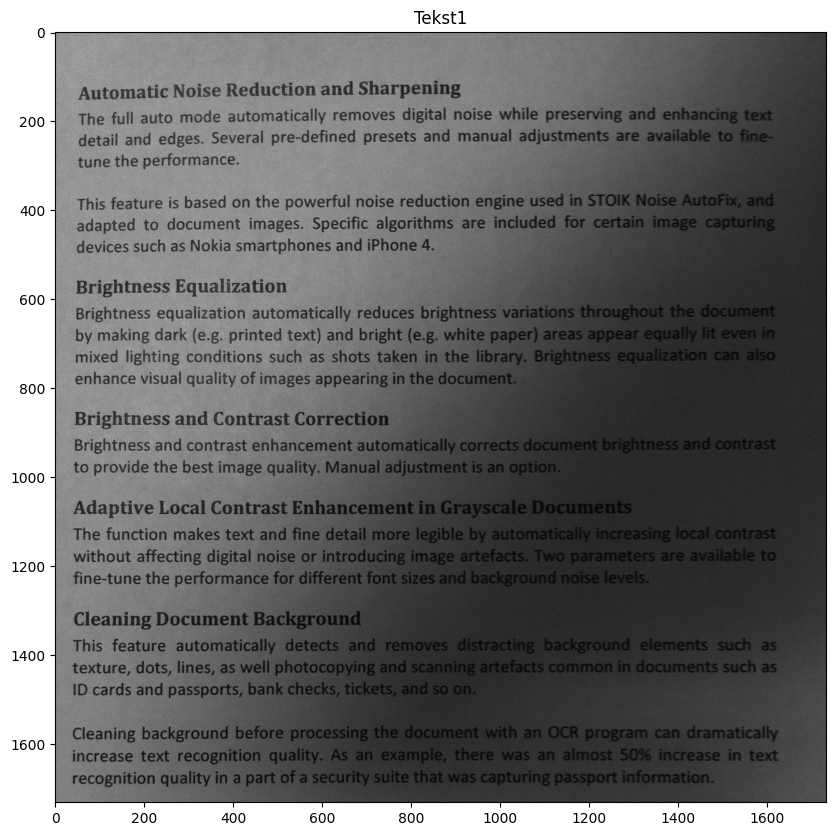

In [71]:
tekst = cv2.imread('Tekst1.bmp')
show_image_with_title(tekst, "Tekst1")

Rozwiązanie:

## Użycie globalnego progu Otsu

Próg wyliczony algorytmem Otsu:  89.0


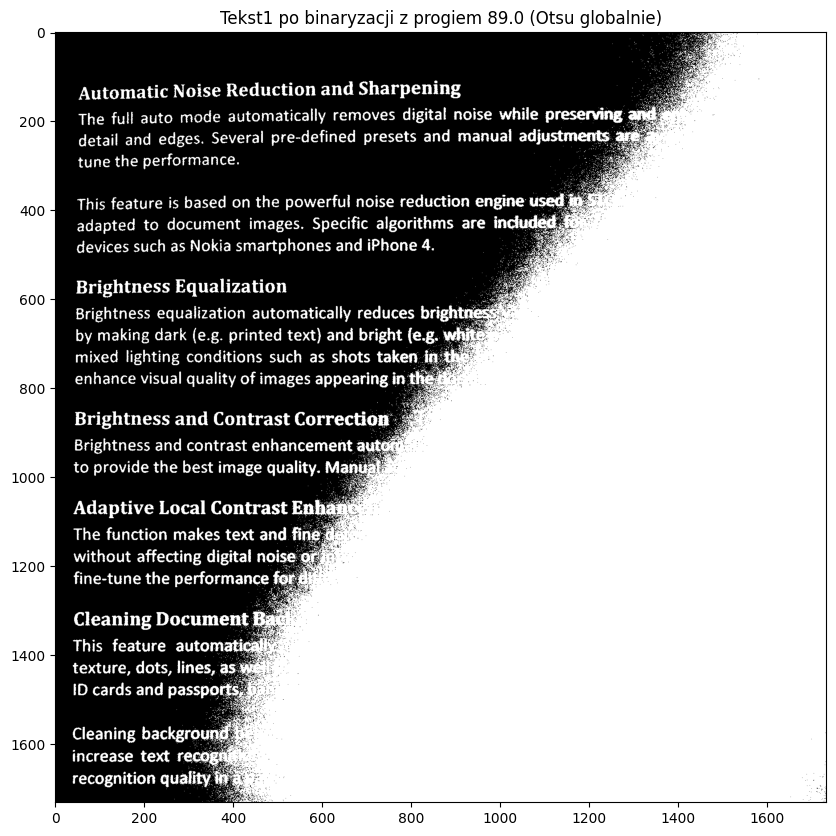

In [72]:
tekst_gray_otso = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
T, tekst_gray_otso_thresh_img = cv2.threshold(
    tekst_gray_otso, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
)
print("Próg wyliczony algorytmem Otsu: ", T)

show_image_with_title(tekst_gray_otso_thresh_img, f"Tekst1 po binaryzacji z progiem {T} (Otsu globalnie)")


## Użycie gausowskiego filtra do wygładzenia obrazu

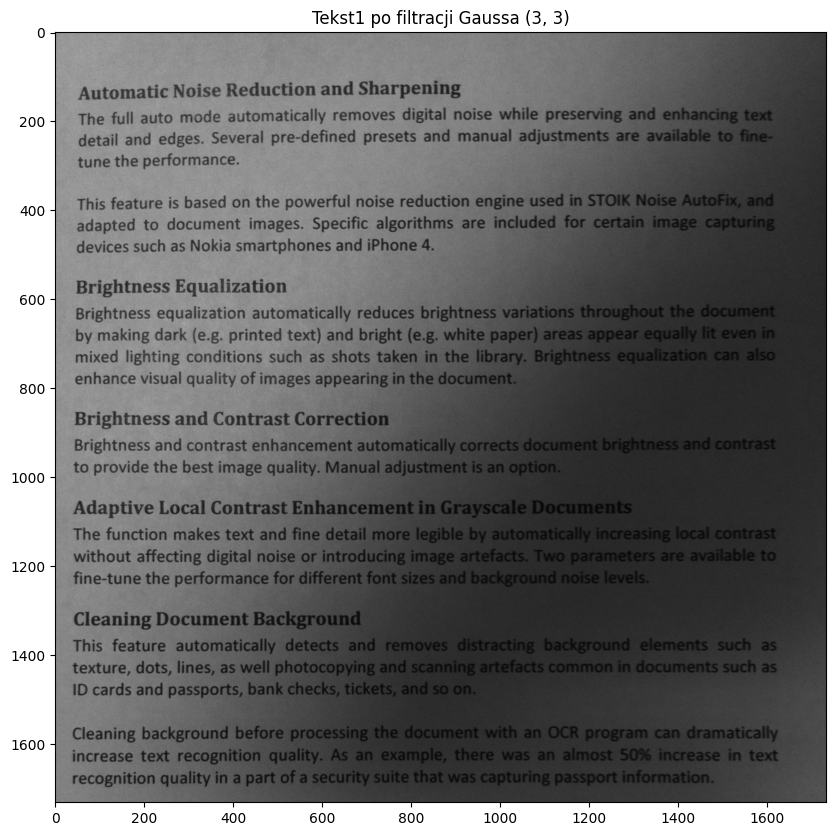

In [73]:
tekst_blur = cv2.GaussianBlur(tekst, (3, 3), 0)

show_image_with_title(tekst_blur, "Tekst1 po filtracji Gaussa (3, 3)")

## Implementacja okna przesuwnego wraz z filtracją używając średniej wartości pikseli w oknie

In [120]:
def apply_adaptive_threshold_mean(image, block_size, c):
    if block_size % 2 == 0:
        raise ValueError("block_size must be odd")

    height, width = image.shape
    output_image = np.zeros_like(image)

    half_window = block_size // 2

    padded_image = cv2.copyMakeBorder(
        image, half_window, half_window, half_window, half_window, cv2.BORDER_REPLICATE
    )

    for y in range(height):
        for x in range(width):
            local_window = padded_image[y : y + block_size, x : x + block_size]
            threshold = np.mean(local_window) - c
            output_image[y, x] = 0 if image[y, x] > threshold else 255

    return output_image

## Badanie wpływu rozmiaru okna na jakość binaryzacji

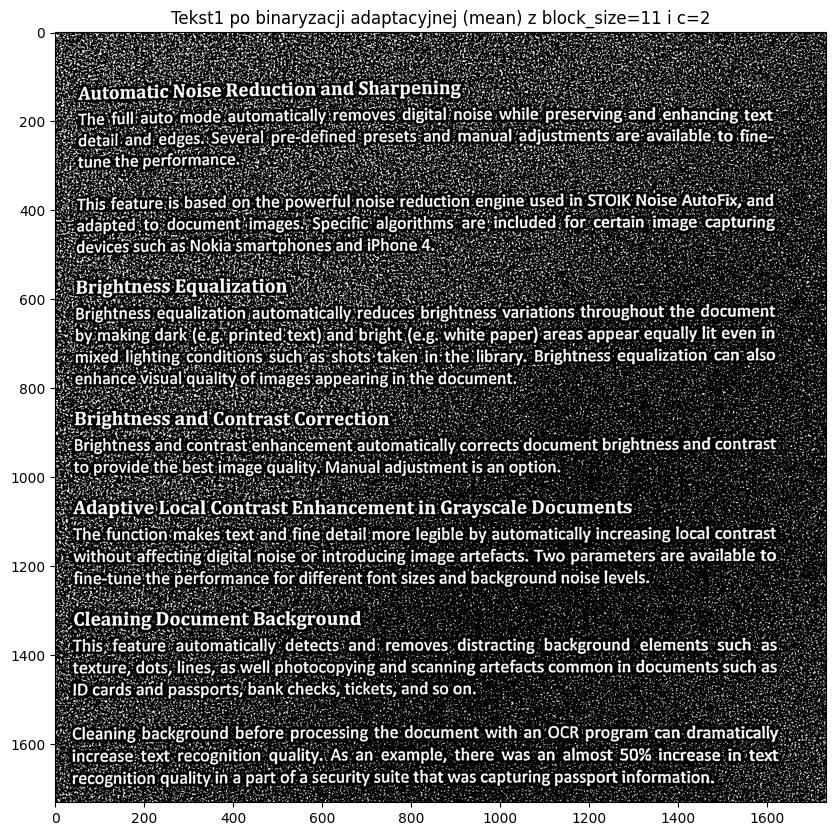

In [121]:
block_size = 11
c = 2
tekst_gray = cv2.cvtColor(tekst_blur, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_mean(tekst_gray, block_size, c)

show_image_with_title(
    tekst_thresh,
    f"Tekst1 po binaryzacji adaptacyjnej (mean) z block_size={block_size} i c={c}",
)

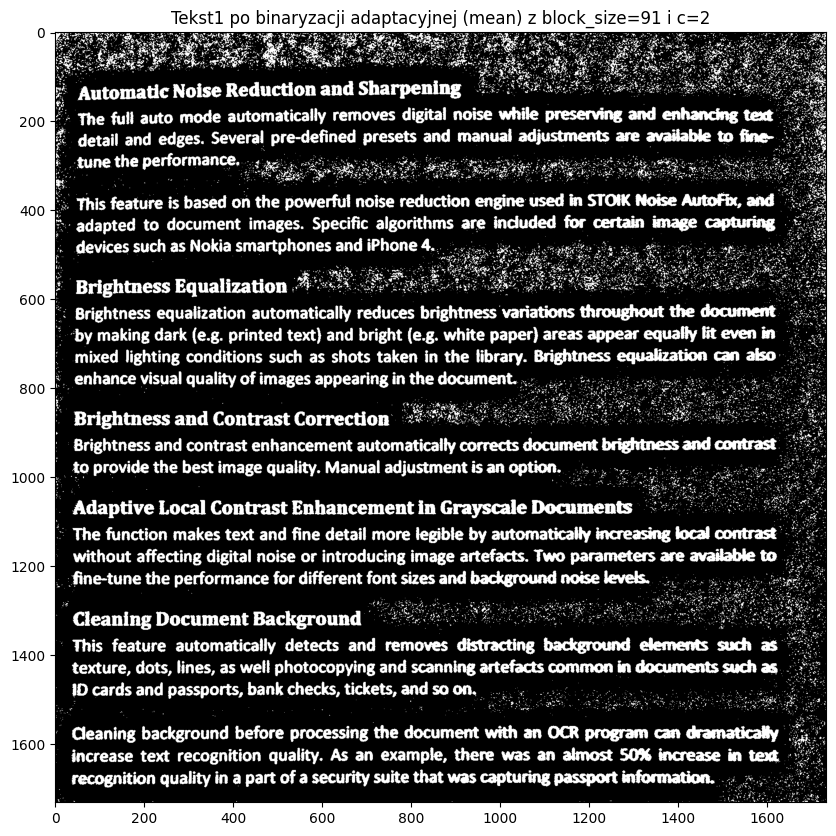

In [76]:
block_size = 91
c = 2
tekst_gray = cv2.cvtColor(tekst_blur, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_mean(tekst_gray, block_size, c)

show_image_with_title(
    tekst_thresh,
    f"Tekst1 po binaryzacji adaptacyjnej (mean) z block_size={block_size} i c={c}",
)

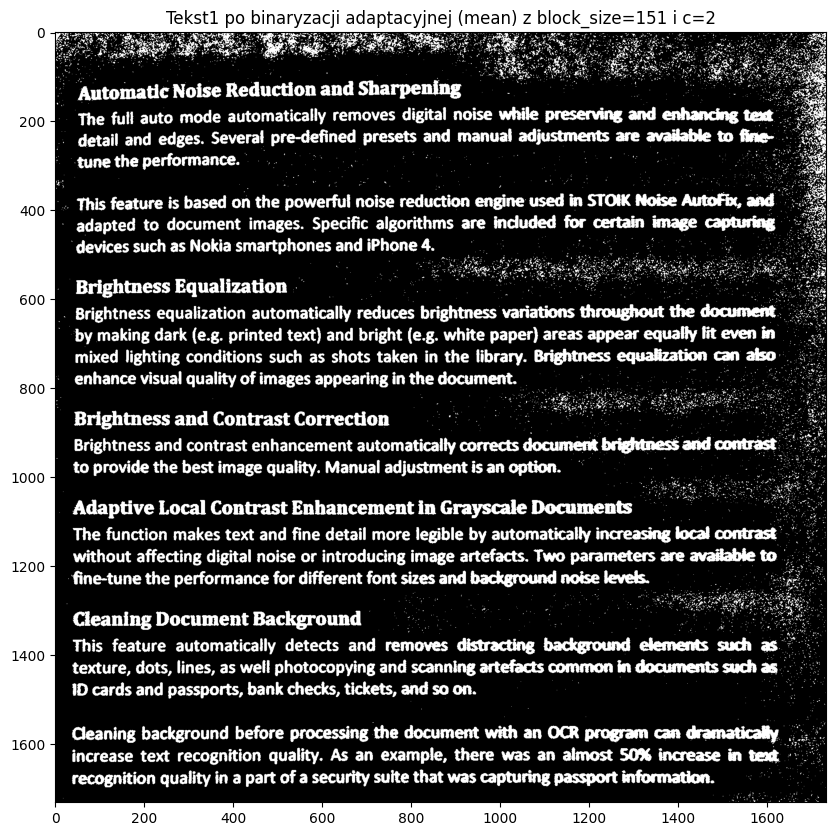

In [77]:
block_size = 151
c = 2
tekst_gray = cv2.cvtColor(tekst_blur, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_mean(tekst_gray, block_size, c)

show_image_with_title(
    tekst_thresh,
    f"Tekst1 po binaryzacji adaptacyjnej (mean) z block_size={block_size} i c={c}",
)

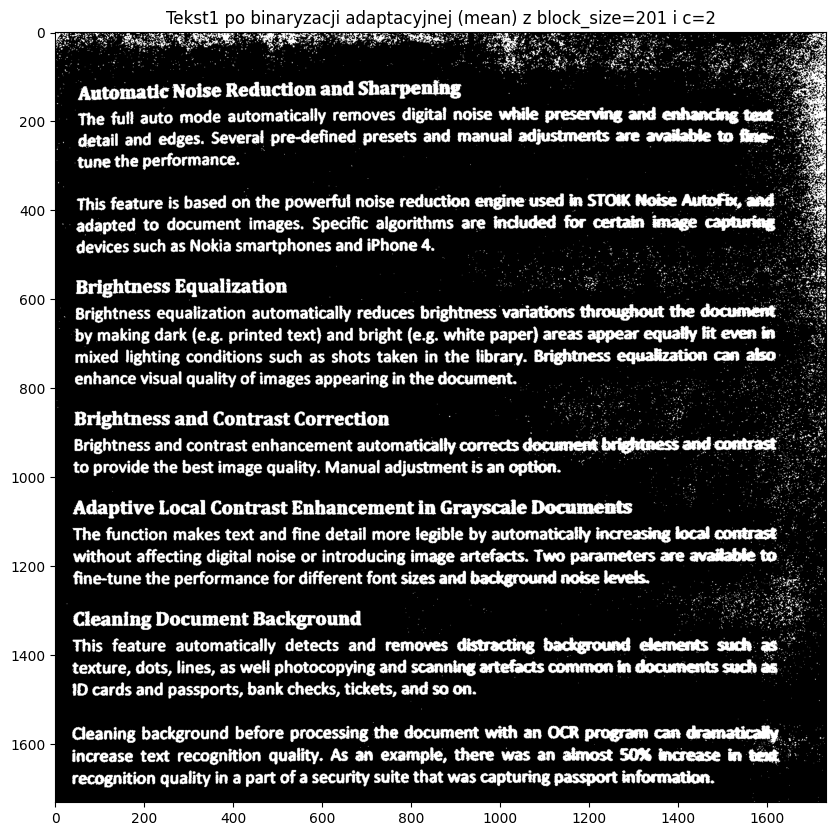

In [78]:
block_size = 201
c = 2
tekst_gray = cv2.cvtColor(tekst_blur, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_mean(tekst_gray, block_size, c)

show_image_with_title(tekst_thresh, f"Tekst1 po binaryzacji adaptacyjnej (mean) z block_size={block_size} i c={c}")

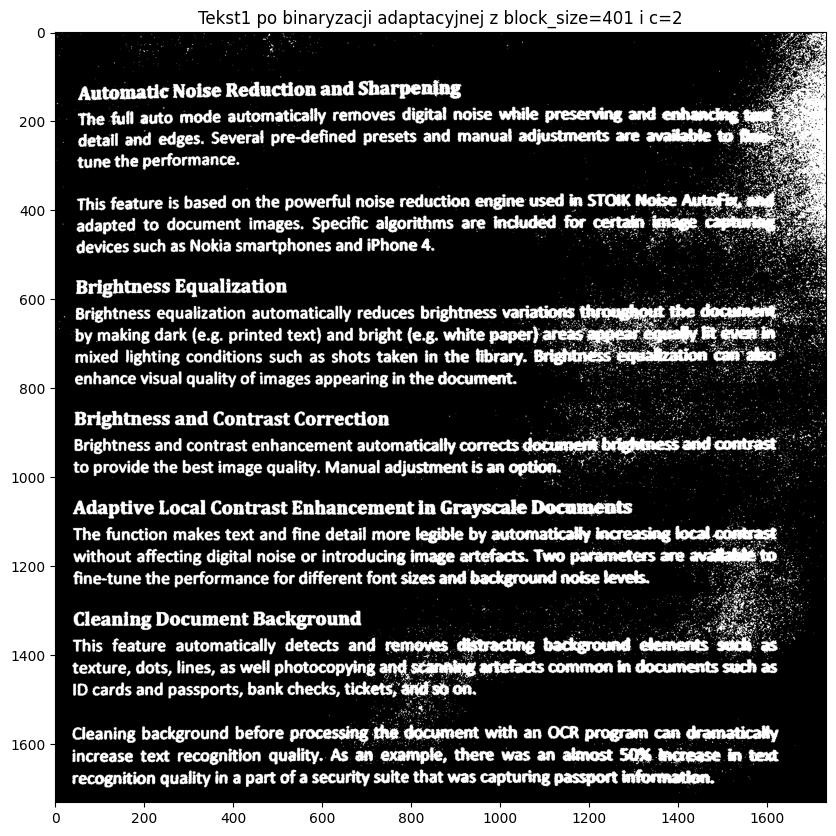

In [79]:
block_size = 401
c = 2
tekst_gray = cv2.cvtColor(tekst_blur, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_mean(tekst_gray, block_size, c)

show_image_with_title(tekst_thresh, f"Tekst1 po binaryzacji adaptacyjnej z block_size={block_size} i c={c}")

## Końcowe parametry dające akceptowalne wyniki

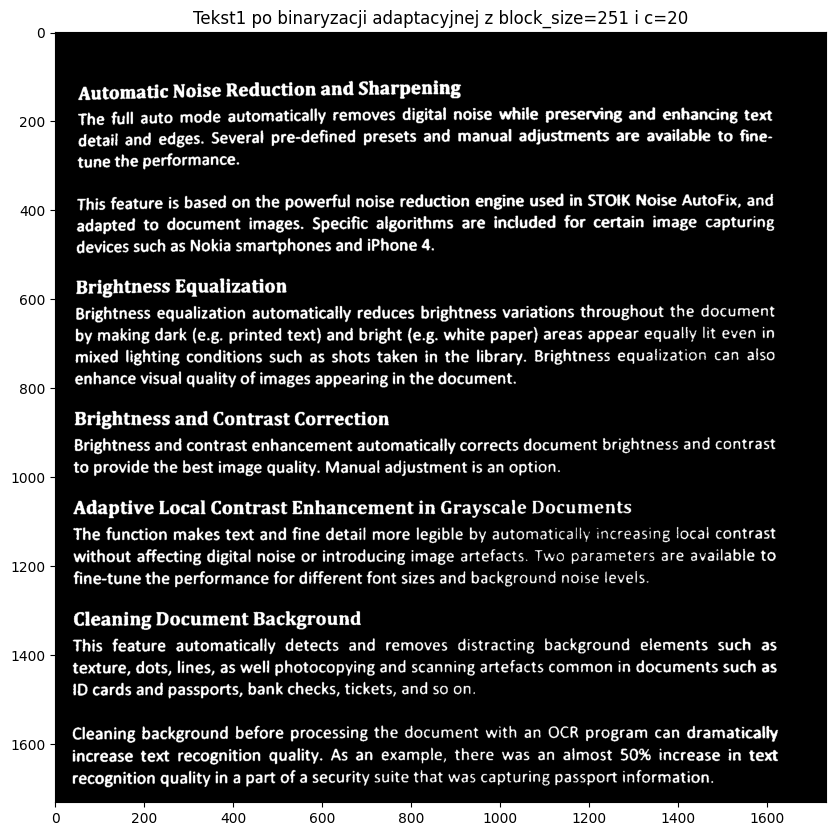

In [80]:
block_size = 251
c = 20
tekst_gray = cv2.cvtColor(tekst_blur, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_mean(tekst_gray, block_size, c)

show_image_with_title(tekst_thresh, f"Tekst1 po binaryzacji adaptacyjnej z block_size={block_size} i c={c}")

4. Implemetacja okna przesuwnego, używając progu wyznaczonego metodą Otsu wewnątrz okna.

In [99]:
def apply_adaptive_threshold_otsu(image, block_size, c = 0):
    if block_size % 2 == 0:
        raise ValueError("block_size must be an odd number")

    height, width = image.shape
    output_image = np.zeros_like(image)

    half_window = block_size // 2

    padded_image = cv2.copyMakeBorder(
        image, half_window, half_window, half_window, half_window, cv2.BORDER_REFLECT
    )

    for y in range(height):
        for x in range(width):

            local_window = padded_image[y : y + block_size, x : x + block_size]
            
            T, img_thres = cv2.threshold(
                local_window, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
            )
            T = T - c
            _, img_thres = cv2.threshold(local_window, T, 255, cv2.THRESH_BINARY_INV)

            output_image[y, x] = img_thres[
                local_window.shape[0] // 2, local_window.shape[1] // 2
            ]

    return output_image

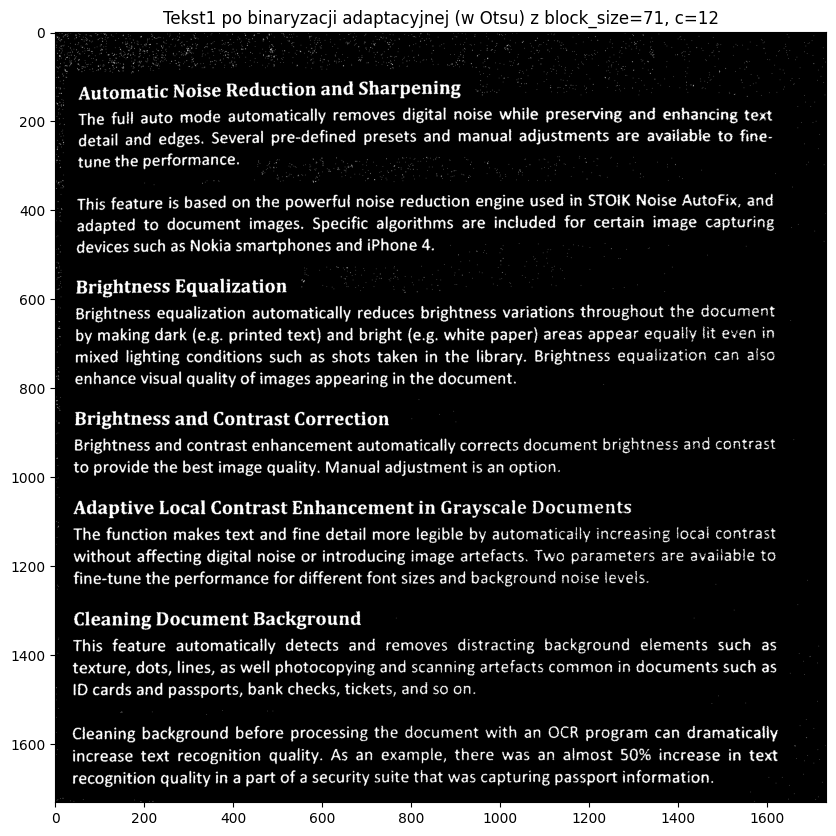

In [115]:
block_size = 71
c = 12
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_otsu(tekst_gray, block_size, c)

show_image_with_title(
    tekst_thresh,
    f"Tekst1 po binaryzacji adaptacyjnej (w Otsu) z block_size={block_size}, c={c}",
)

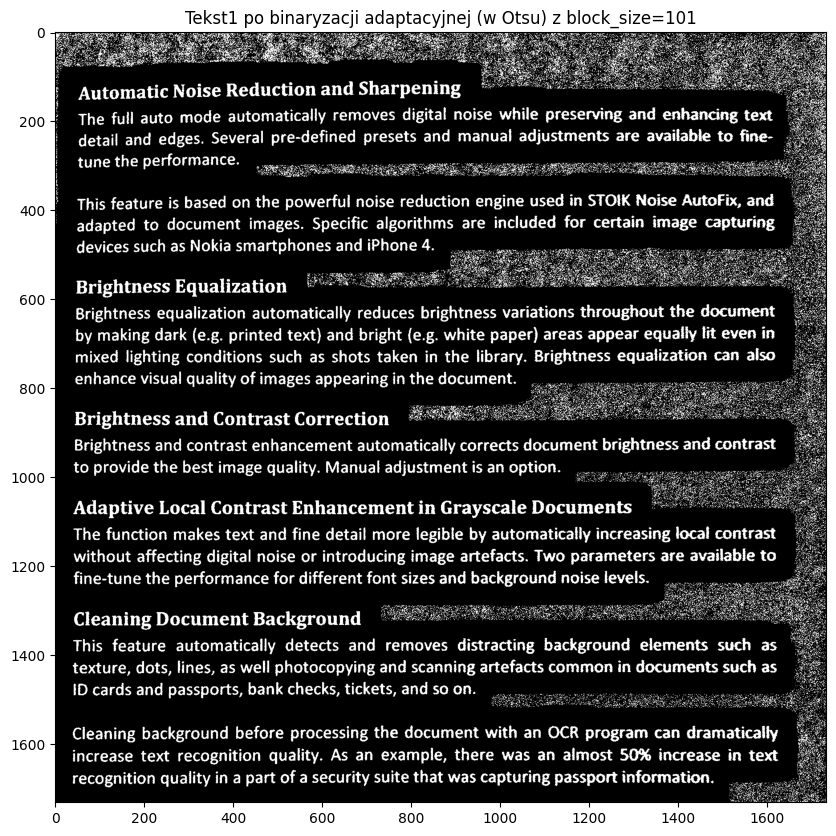

In [101]:
block_size = 101
c = 2
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_otsu(tekst_gray, block_size, c)

show_image_with_title(tekst_thresh, f"Tekst1 po binaryzacji adaptacyjnej (w Otsu) z block_size={block_size}")

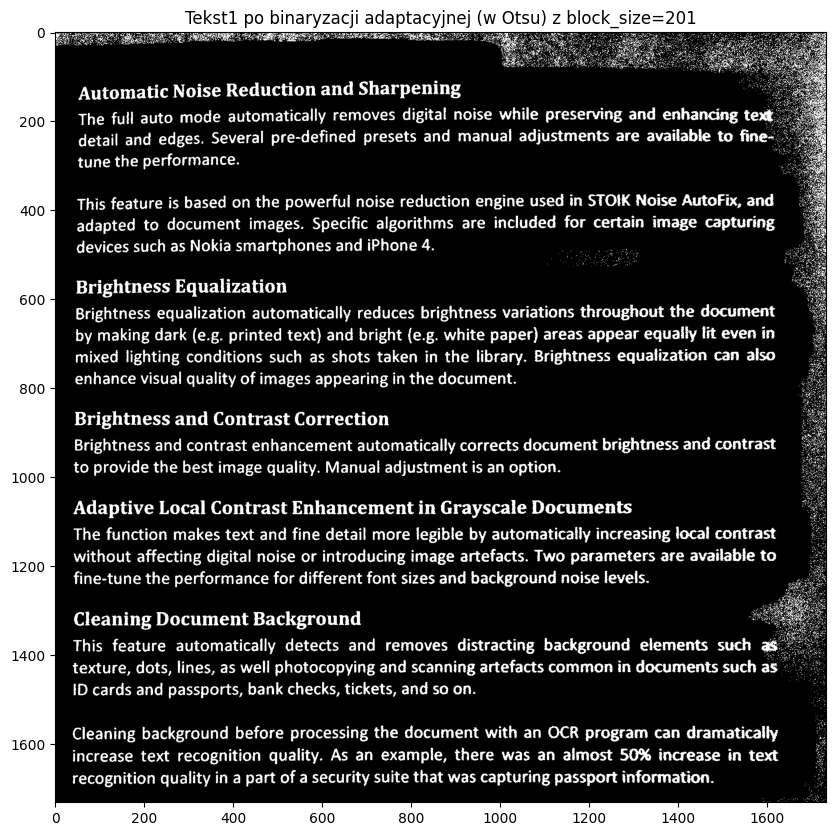

In [102]:
block_size = 201
c = 2
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_otsu(tekst_gray, block_size, c)

show_image_with_title(tekst_thresh, f"Tekst1 po binaryzacji adaptacyjnej (w Otsu) z block_size={block_size}")

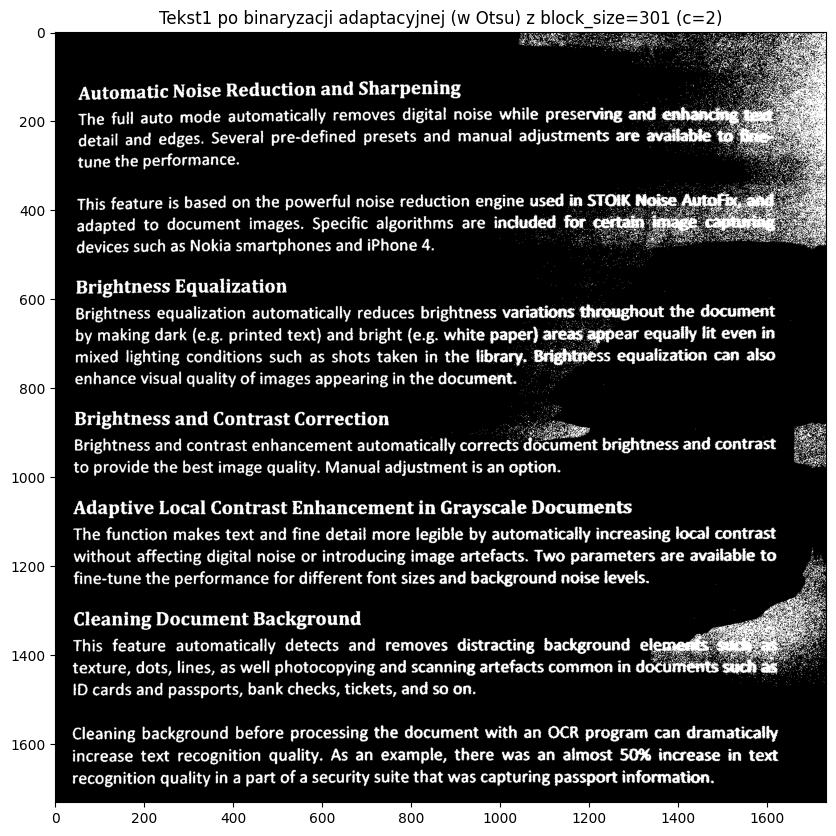

In [103]:
block_size = 301
c = 2
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_otsu(tekst_gray, block_size)

show_image_with_title(tekst_thresh, f"Tekst1 po binaryzacji adaptacyjnej (w Otsu) z block_size={block_size} (c={c})")

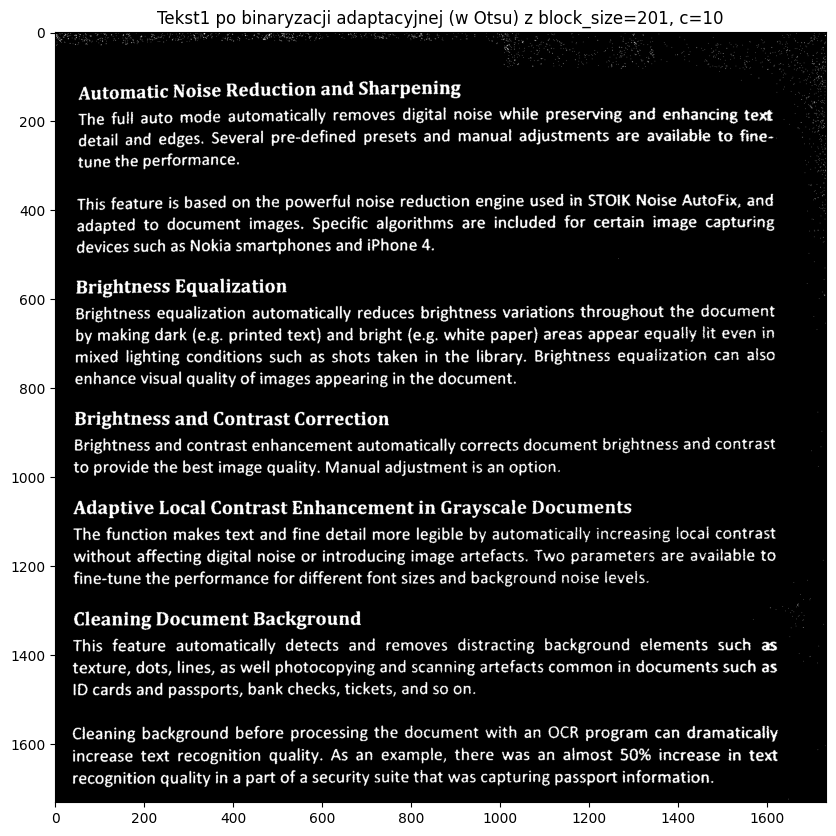

In [106]:
block_size = 201
c = 10
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_otsu(tekst_gray, block_size, c)

show_image_with_title(tekst_thresh, f"Tekst1 po binaryzacji adaptacyjnej (w Otsu) z block_size={block_size}, c={c}")

W miarę akceptowalne

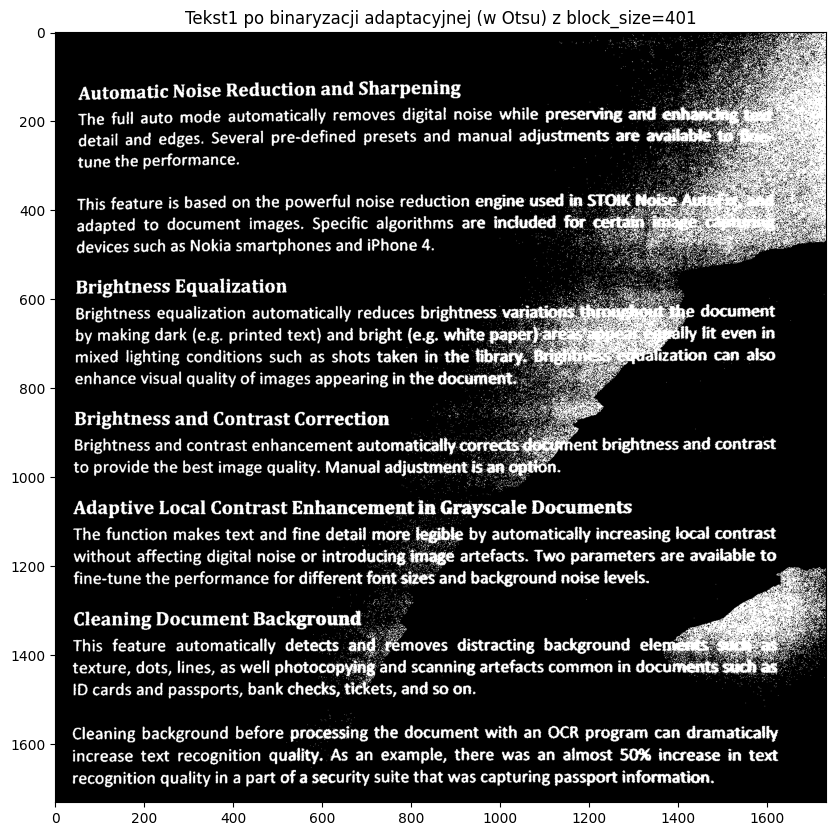

In [86]:
block_size = 401
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)
tekst_thresh = apply_adaptive_threshold_otsu(tekst_gray, block_size)

show_image_with_title(tekst_thresh, f"Tekst1 po binaryzacji adaptacyjnej (w Otsu) z block_size={block_size}")

### Porównanie z cv2.adaptiveThreshold

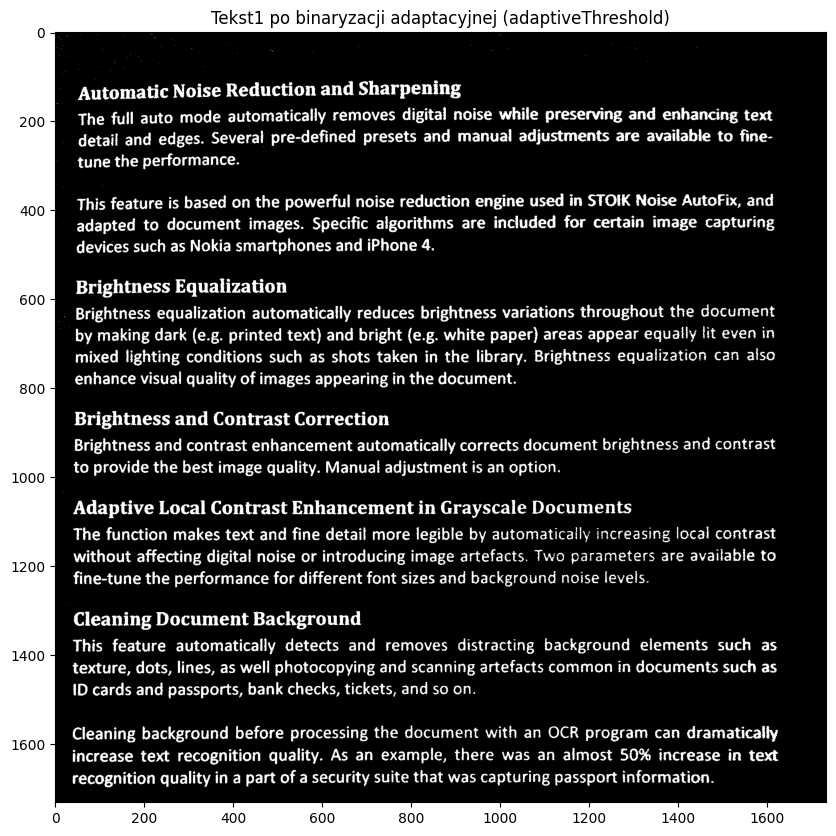

In [88]:
tekst_gray = cv2.cvtColor(tekst, cv2.COLOR_BGR2GRAY)

adaptive_thresh = cv2.adaptiveThreshold(
    tekst_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 251, 20
)

show_image_with_title(
    adaptive_thresh, "Tekst1 po binaryzacji adaptacyjnej (adaptiveThreshold)"
)